In [ ]:

import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.svm import SVC
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation
from IPython.display import HTML


In [ ]:

X, y = make_classification(
    n_samples=300, n_features=3, n_redundant=0, n_clusters_per_class=1,
    class_sep=1.5, random_state=42
)


In [ ]:

clf = SVC(kernel='rbf', gamma='auto')
clf.fit(X, y)


SVC(gamma='auto')

In [ ]:

def plot_decision_surface(clf, X, y, elev=30, azim=45):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')


    scatter = ax.scatter(X[:, 0], X[:, 1], X[:, 2], c=y, cmap=plt.cm.coolwarm, s=40)


    xx, yy = np.meshgrid(
        np.linspace(X[:, 0].min() - 1, X[:, 0].max() + 1, 30),
        np.linspace(X[:, 1].min() - 1, X[:, 1].max() + 1, 30)
    )
    zz = np.linspace(X[:, 2].min() - 1, X[:, 2].max() + 1, 30)

    for z in zz:
        xy = np.c_[xx.ravel(), yy.ravel(), np.full(xx.ravel().shape, z)]
        Z = clf.decision_function(xy).reshape(xx.shape)

        ax.contour3D(xx, yy, Z, 0, zdir='z', offset=z, alpha=0.2, cmap="coolwarm")

    ax.view_init(elev, azim)
    ax.set_xlabel("X1")
    ax.set_ylabel("X2")
    ax.set_zlabel("X3")
    plt.title("💥 3D SVM Decision Surface 💥")
    return fig, ax


<ipython-input-5-f06a523192dd>:9: UserWarning: Glyph 128165 (\N{COLLISION SYMBOL}) missing from font(s) DejaVu Sans.
  HTML(ani.to_jshtml())


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128165 (\N{COLLISION SYMBOL}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


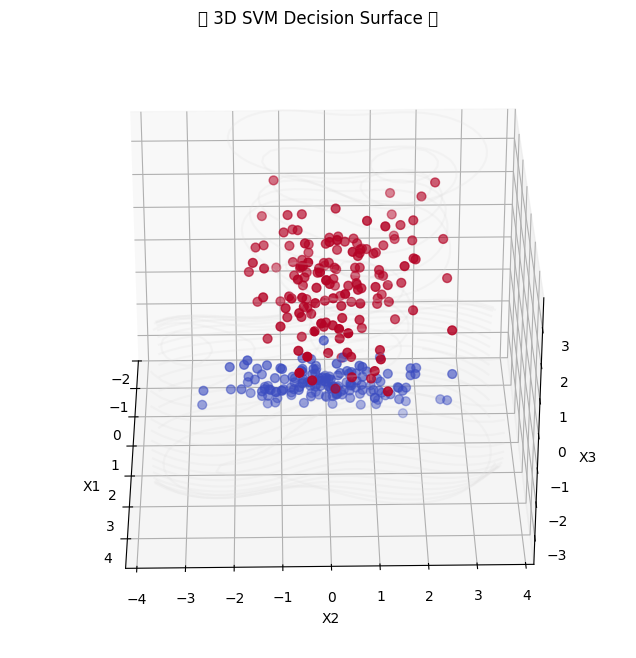

In [ ]:
fig, ax = plot_decision_surface(clf, X, y, elev=30, azim=0)

def animate(i):
    ax.view_init(elev=30, azim=i)
    return fig,

ani = animation.FuncAnimation(fig, animate, frames=360, interval=30)
HTML(ani.to_jshtml())
